In [ ]:
!pip install openmim
!mim install mmdet
!git clone https://github.com/open-mmlab/mmdetection.git
%cd mmdetection
!pip3 install .

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 50 kB 6.8 MB/s 
     |████████████████████████████████| 237 kB 50.2 MB/s 
     |████████████████████████████████| 51 kB 1.0 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.openmmlab.com/mmcv/dist/cu113/torch1.12.0/index.html
     |████████████████████████████████| 1.4 MB 19.2 MB/s 
     |████████████████████████████████| 43.7 MB 6.3 MB/s 
     |████████████████████████████████| 190 kB 56.1 MB/s 
Cloning into 'mmdetection'...
remote: Enumerating objects: 32369, done.
remote: Counting objects: 100% (31/31), done.
remote: Compressing objects: 100% (29/29), done.
remote: Total 32369 (delta 8), reused 11 (delta 2), pack-reused 32338
Receiving objects: 100% (32369/32369), 41.87 MiB | 17.78 MiB/s, done.
Resolving deltas: 100% (23304/23304), done.
/content/mmdetectio

In [ ]:
from google.colab import files
files.upload()         # expire any previous token(s) and upload recreated token

!rm -r ~/.kaggle
!mkdir ~/.kaggle
!mv ./kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets list

Saving kaggle.json to kaggle.json
rm: cannot remove '/root/.kaggle': No such file or directory
ref                                                             title                                            size  lastUpdated          downloadCount  voteCount  usabilityRating  
--------------------------------------------------------------  ----------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
akshaydattatraykhare/diabetes-dataset                           Diabetes Dataset                                  9KB  2022-10-06 08:55:25          10814        345  1.0              
whenamancodes/covid-19-coronavirus-pandemic-dataset             COVID -19 Coronavirus Pandemic Dataset           11KB  2022-09-30 04:05:11           8598        278  1.0              
stetsondone/video-game-sales-by-genre                           Video Game Sales by Genre                        12KB  2022-10-31 17:56:01            730         23  1.0

In [ ]:
!kaggle datasets download viacheslavshalamov/russian-road-signs-segmentation-dataset -p /kaggle/input/russian-road-signs-segmentation-dataset --unzip

 99% 399M/401M [00:21<00:00, 20.3MB/s]
100% 401M/401M [00:21<00:00, 19.7MB/s]


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import os
from tqdm import tqdm
import re
import torch
import json
import mmcv
import mmdet
from mmcv import Config
from mmdet.models import build_detector
from mmcv.runner import load_checkpoint
from mmdet.datasets import build_dataset
from mmdet.apis import train_detector

/usr/local/lib/python3.7/dist-packages/mmcv/__init__.py:21: UserWarning: On January 1, 2023, MMCV will release v2.0.0, in which it will remove components related to the training process and add a data transformation module. In addition, it will rename the package names mmcv to mmcv-lite and mmcv-full to mmcv. See https://github.com/open-mmlab/mmcv/blob/master/docs/en/compatibility.md for more details.
  'On January 1, 2023, MMCV will release v2.0.0, in which it will remove '


In [ ]:
px = 1/plt.rcParams['figure.dpi']

In [ ]:
def get_json(path: str):
    with open(path) as f:
        return json.load(f)

In [ ]:
regions_data = get_json('/kaggle/input/russian-road-signs-segmentation-dataset/sign_dataset/train/via_region_data.json')
regions_data = {k.split('.')[0]: v for k,v in regions_data.items()}

In [ ]:
def get_polygon_from_shape_attributes(shape_attributes):
    if shape_attributes['name'] == 'polygon':
        return np.array(list(zip(shape_attributes['all_points_x'], shape_attributes['all_points_y'])))
    elif shape_attributes['name'] == 'circle':
        patch = patches.Circle((shape_attributes['cx'], shape_attributes['cy']), shape_attributes['r'], fill=False, color='r') 
        t = patch.get_patch_transform()
        points = t.transform(patch.get_path().vertices)
        return points
    elif shape_attributes['name'] == 'ellipse':
        patch = patches.Ellipse((shape_attributes['cx'], shape_attributes['cy']), 2 * shape_attributes['rx'], 2 * shape_attributes['ry'], fill=False, color='r')
        t = patch.get_patch_transform()
        points = t.transform(patch.get_path().vertices)
        return points
    elif shape_attributes['name'] == 'rect':
        patch = patches.Rectangle((shape_attributes['x'], shape_attributes['y']), shape_attributes['width'], shape_attributes['height'], fill=False, color='r')
        t = patch.get_patch_transform()
        points = t.transform(patch.get_path().vertices)
        return points
    else:
        raise Exception("Unknown shape")

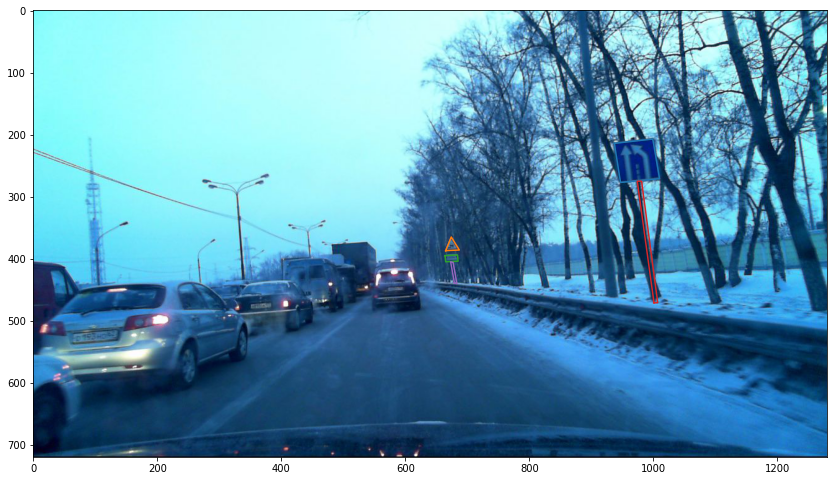

In [ ]:
idx = 1
example_img = Image.open(f'/kaggle/input/russian-road-signs-segmentation-dataset/sign_dataset/train/{idx}.jpg')
example_meta = get_json(f'/kaggle/input/russian-road-signs-segmentation-dataset/sign_dataset/train/{idx}.jpg_coco.json')
example_regions = regions_data[f'{idx}']
fig, ax = plt.subplots(figsize=(1024 * px, 720  * px))


ax.imshow(example_img)

for _, samp_data in example_regions['regions'].items():
    shape_attributes = samp_data['shape_attributes']
    region_attributes = samp_data['region_attributes']
    points = get_polygon_from_shape_attributes(shape_attributes)
    plt.plot(points[:, 0], points[:, 1])

In [ ]:
def convert_to_coco_dataset(path: str, out_file:str, width: int = 1280, height: int = 720):
    images, annotations = [], []
    regions = get_json(f'{path}/via_region_data.json')
    image_names = list(filter(
        lambda name: re.match(r"^.+?\.jpg$", name),
        os.listdir(path)
    ))
    item_id = 0
    for unique_image_id, (filename, cur_regions_data) in tqdm(enumerate(regions.items())):
        img_id = int(filename.split('.')[0])
        img_meta = get_json(f'{path}/{img_id}.jpg_coco.json')
        
        image_dict = {
            "id": unique_image_id,
            "width": width,
            "height": height,
            "file_name":filename.split('.')[0] + '.jpg'
        }
        
        images.append(image_dict)
        
        for i, samp_data in cur_regions_data['regions'].items():
            shape_attributes = samp_data['shape_attributes']
            region_attributes = samp_data['region_attributes']
            points = get_polygon_from_shape_attributes(shape_attributes)
            xs, ys = points[:-1, 0], points[:-1, 1]
            
            x_min, y_min, x_max, y_max = np.min(xs), np.min(ys), np.max(xs), np.max(ys)
            bbox_w, bbox_h = x_max - x_min, y_max - y_min
            area = bbox_w * bbox_h
            bbox = [x_min, y_min, bbox_w, bbox_h]
            
            annotation = {
                "id": item_id,
                "image_id": unique_image_id,
                "category_id": 0,
                "segmentation": [np.concatenate([(x, y) for x, y in zip(xs, ys)])],
                "area": area,
                "bbox": bbox,
                "iscrowd": 0,
            }
            item_id += 1
            
            annotations.append(annotation)
    coco_json = {
        'images': images,
        'annotations': annotations,
        'categories': [{'id':0, 'name': f'sign_test'}]
    }
    mmcv.dump(coco_json, out_file)

In [ ]:
convert_to_coco_dataset('/kaggle/input/russian-road-signs-segmentation-dataset/sign_dataset/train', '/kaggle/working/train_coco.json')
convert_to_coco_dataset('/kaggle/input/russian-road-signs-segmentation-dataset/sign_dataset/val', '/kaggle/working/test_coco.json')

2054it [00:06, 296.99it/s]
127it [00:00, 328.46it/s]


In [ ]:
!mkdir checkpoints
!wget -c https://download.openmmlab.com/mmdetection/v2.0/mask_rcnn/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth \
      -O checkpoints/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth

--2022-11-09 13:41:08--  https://download.openmmlab.com/mmdetection/v2.0/mask_rcnn/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth
Resolving download.openmmlab.com (download.openmmlab.com)... 47.74.197.92
Connecting to download.openmmlab.com (download.openmmlab.com)|47.74.197.92|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 177867103 (170M) [application/octet-stream]
Saving to: ‘checkpoints/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth’

checkpoints/mask_rc 100%[===================>] 169.63M  12.0MB/s    in 14s     

2022-11-09 13:41:21 (12.5 MB/s) - ‘checkpoints/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth’ saved [177867103/177867103]



In [ ]:
checkpoint = 'checkpoints/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth'
base = '../mmdetection/configs/mask_rcnn/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco.py'

cfg = mmcv.Config.fromfile(base)

In [ ]:
from mmdet.apis import set_random_seed

cfg.dataset_type = 'COCODataset'

cfg.data.train.ann_file = '/kaggle/working/train_coco.json'
cfg.data.train.img_prefix = '/kaggle/input/russian-road-signs-segmentation-dataset/sign_dataset/train/'
cfg.data.train.classes = ('sign_test',)

cfg.model.roi_head.bbox_head.num_classes = 1
cfg.model.roi_head.mask_head.num_classes = 1

cfg.load_from = checkpoint

cfg.work_dir = '/kaggle/working/segmentation_hw_1'

cfg.optimizer.lr = 0.001
cfg.lr_config.warmup = None
cfg.log_config.interval = 10

cfg.checkpoint_config.interval = 2
cfg.runner.max_epochs = 5

cfg.seed = 0
set_random_seed(0, deterministic=False)
cfg.device = 'cuda'
cfg.gpu_ids = range(1)

cfg.log_config.hooks = [dict(type='TextLoggerHook')]

In [ ]:
datasets = [build_dataset(cfg.data.train)]
model = build_detector(cfg.model)
model.CLASSES = datasets[0].CLASSES
mmcv.mkdir_or_exist(os.path.abspath(cfg.work_dir))
train_detector(model, datasets, cfg, distributed=False, validate=False)

loading annotations into memory...
Done (t=0.16s)
creating index...
index created!


2022-11-09 13:41:27,155 - mmdet - INFO - Automatic scaling of learning rate (LR) has been disabled.
2022-11-09 13:41:27,162 - mmdet - INFO - load checkpoint from local path: checkpoints/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth
2022-11-09 13:41:27,302 - mmdet - WARNING - The model and loaded state dict do not match exactly

size mismatch for roi_head.bbox_head.fc_cls.weight: copying a param with shape torch.Size([81, 1024]) from checkpoint, the shape in current model is torch.Size([2, 1024]).
size mismatch for roi_head.bbox_head.fc_cls.bias: copying a param with shape torch.Size([81]) from checkpoint, the shape in current model is torch.Size([2]).
size mismatch for roi_head.bbox_head.fc_reg.weight: copying a param with shape torch.Size([320, 1024]) from checkpoint, the shape in current model is torch.Size([4, 1024]).
size mismatch for roi_head.bbox_head.fc_reg.bias: copying a param with shape torch.Size([320]) from checkpoin

KeyboardInterrupt: ignored

In [ ]:
from mmdet.apis import init_detector, inference_detector, show_result_pyplot

In [ ]:
!cp /kaggle/working/segmentation_hw_1/latest.pth /kaggle/working/latest.pth

In [ ]:
trained = '/kaggle/working/latest.pth'
model = init_detector(cfg, trained, device='cuda:0')

load checkpoint from local path: /kaggle/working/latest.pth


/content/mmdetection/mmdet/datasets/utils.py:70: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  'data pipeline in your config file.', UserWarning)


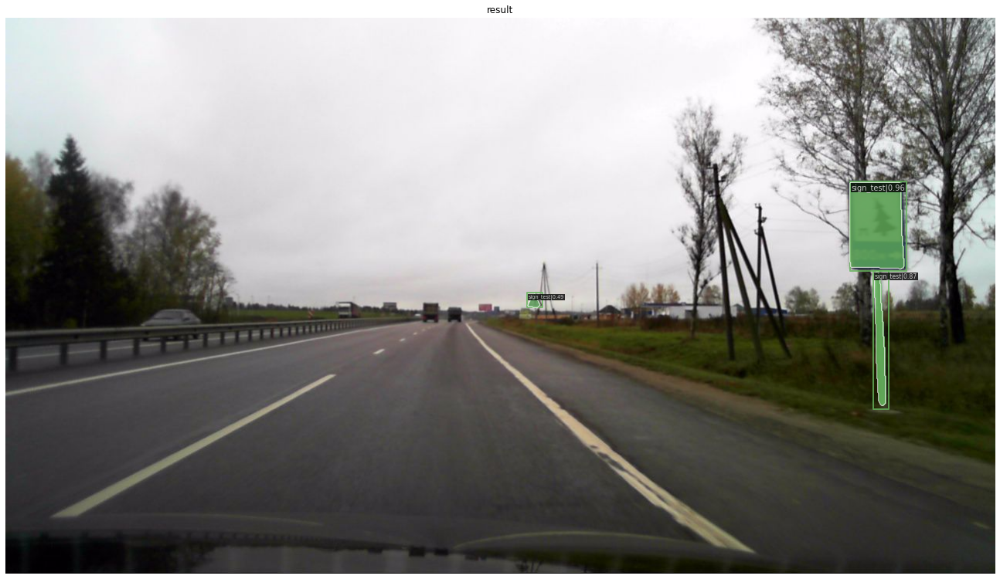

In [ ]:
img = mmcv.imread('/kaggle/input/russian-road-signs-segmentation-dataset/sign_dataset/val/203.jpg')
result = inference_detector(model, img)
show_result_pyplot(model, img, result)

In [ ]:
!pip3 install imantics

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Created wheel for imantics: filename=imantics-0.1.12-py3-none-any.whl size=16033 sha256=cf680e76558e47b5f26e1873d151c91022931367886dade07370329da409ab2d
  Stored in directory: /root/.cache/pip/wheels/da/7c/3e/296fe3ed4eb3bd713e91dee0d0549f12f316d49939a64bdc96
Successfully built imantics


In [ ]:
test_json = get_json('/kaggle/working/test_coco.json')

In [ ]:
import pandas as pd
from imantics import Polygons, Mask
from functools import reduce
import shapely.geometry as geom
from shapely.geometry import Polygon

In [ ]:
def chunks(lst, n):
    for i in range(0, len(lst), n):
        yield lst[i:i + n]
        
def iou(left, right):
    res = left.intersection(right)
    
    score = res.area / (left.area + right.area - res.area)
    return score

def iou_precision_recall_for_image(predicts, targets):
    res = []
    for i, left in enumerate(targets):
        res.append([])
        for right in predicts:
            iou_score = iou(left, right)

            numerator = left.intersection(right).area
            precision_denominator = right.area
            recall_denominator = left.area

            res[i].append((iou_score, numerator / precision_denominator, numerator / recall_denominator))

    return list(zip(*list(map(lambda scores: max(scores, key=lambda x: x[0], default=[0.0, 0.0, 0.0]), res))))
  

In [ ]:
images_df = pd.DataFrame(test_json['images'])
annotations_df = pd.DataFrame(test_json['annotations'])

ious = []
precisions = []
recalls = []
l2s = []

for i, row in images_df.iterrows():
    file_name = row.file_name
    path = os.path.join('/kaggle/input/russian-road-signs-segmentation-dataset/sign_dataset/val/', file_name)
    img = mmcv.imread(path)
    
    result = inference_detector(model, img)
    pred_points = list(filter(lambda x: len(x) >= 3, map(lambda mask: Mask(mask).polygons().points[0] if Mask(mask).polygons().points else [], result[1][0])))
    pred_polygons = list(map(lambda x: Polygon(x), pred_points))
    
    targets = annotations_df[row.id == annotations_df.image_id]['segmentation'].apply(lambda x: list(chunks(x[0], 2))).tolist()
    target_polygons = list(map(lambda x: Polygon(x), targets))
    target_polygons = list(map(lambda x: x if x.is_valid else x.buffer(0), target_polygons))

    
    pred_mask = reduce(lambda acc, x: acc | x, result[1][0]).astype(float)
    h, w = pred_mask.shape
    target_mask = reduce(lambda acc, x: acc | Polygons([x]).mask(width=w, height=h).array, targets[1:], Polygons([targets[0]]).mask(width=w, height=h).array).astype(float)
    
    iou_scores, precision_scores, recall_scores = iou_precision_recall_for_image(
        pred_polygons, target_polygons
    )

    ious.append(np.array(iou_scores).mean())
    precisions.append(np.array(precision_scores).mean())
    recalls.append(np.array(recall_scores).mean())
    l2s.append(((target_mask - pred_mask) ** 2).mean())

In [ ]:
ious = np.array(ious)
precisions = np.array(precisions)
recalls = np.array(recalls)
l2s = np.array(l2s)

In [ ]:
print(f"IOU: {ious.mean()}\nPrecision: {precisions.mean()}\nRecall: {recalls.mean()}\nL2: {l2s.mean()}\nIOUs[>0.5]: {100 * len(ious[ious > 0.5]) / len(ious)}\nIOUs[>0.75]: {100 * len(ious[ious > 0.75]) / len(ious)}\nIOUs[>0.9]: {100 * len(ious[ious > 0.9]) / len(ious)}")

IOU: 0.6919155580956909
Precision: 0.8320765705914552
Recall: 0.7448468765007937
L2: 0.005760383043989571
IOUs[>0.5]: 86.61417322834646
IOUs[>0.75]: 49.60629921259842
IOUs[>0.9]: 4.724409448818897


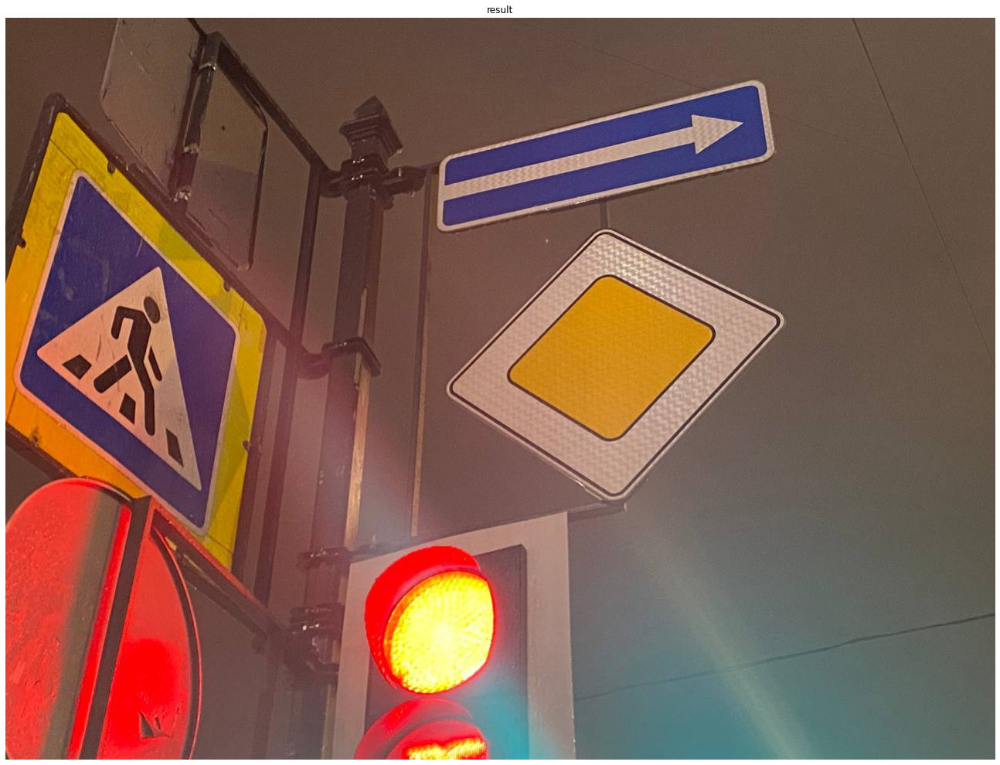

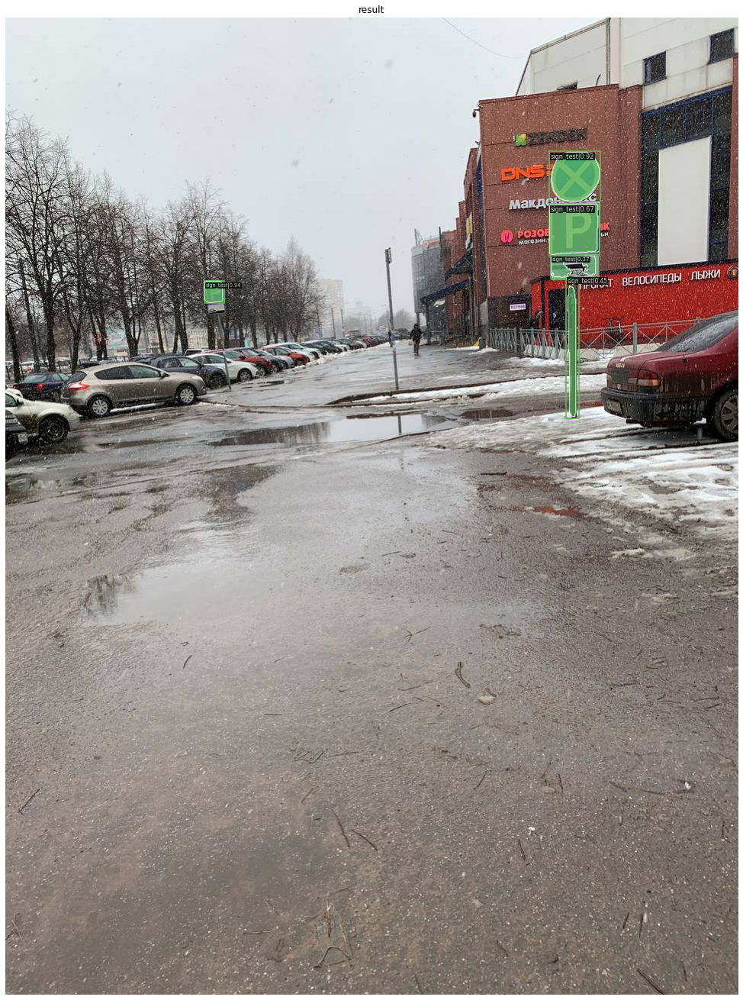

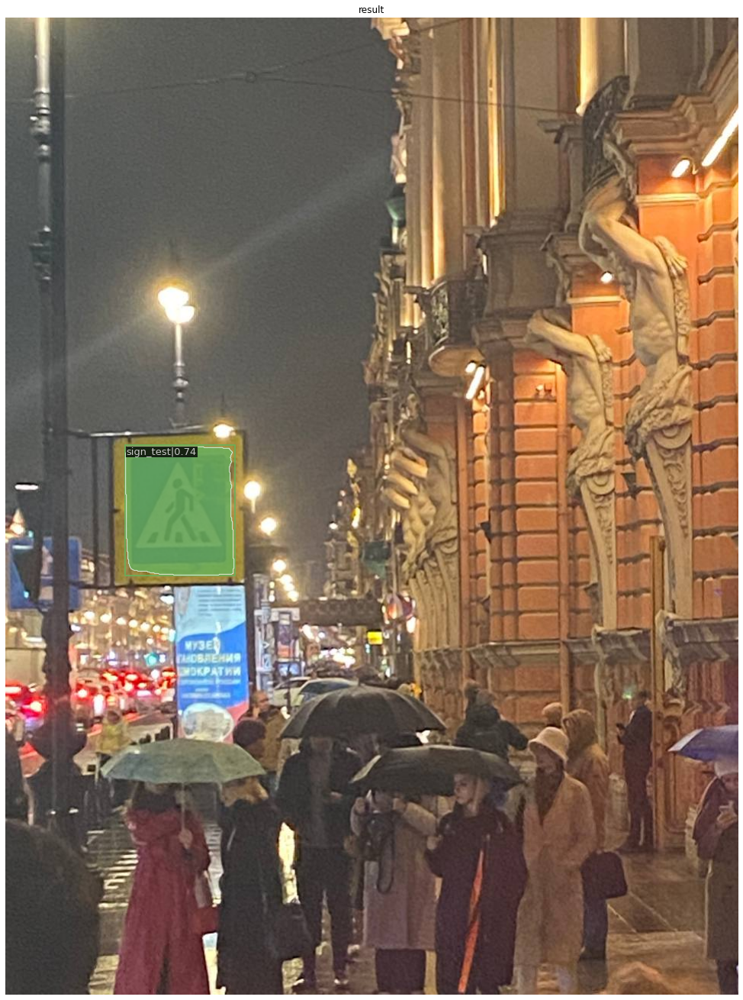

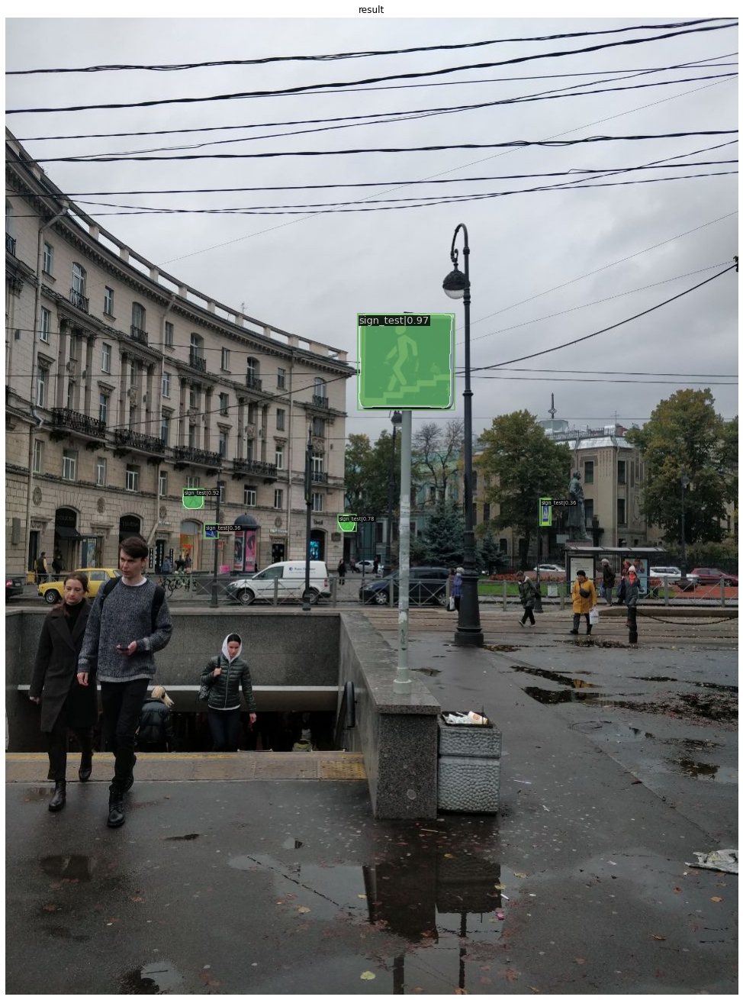

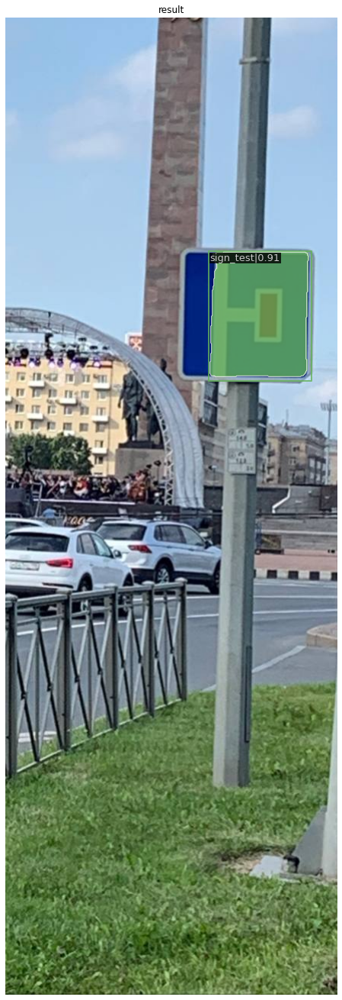

...

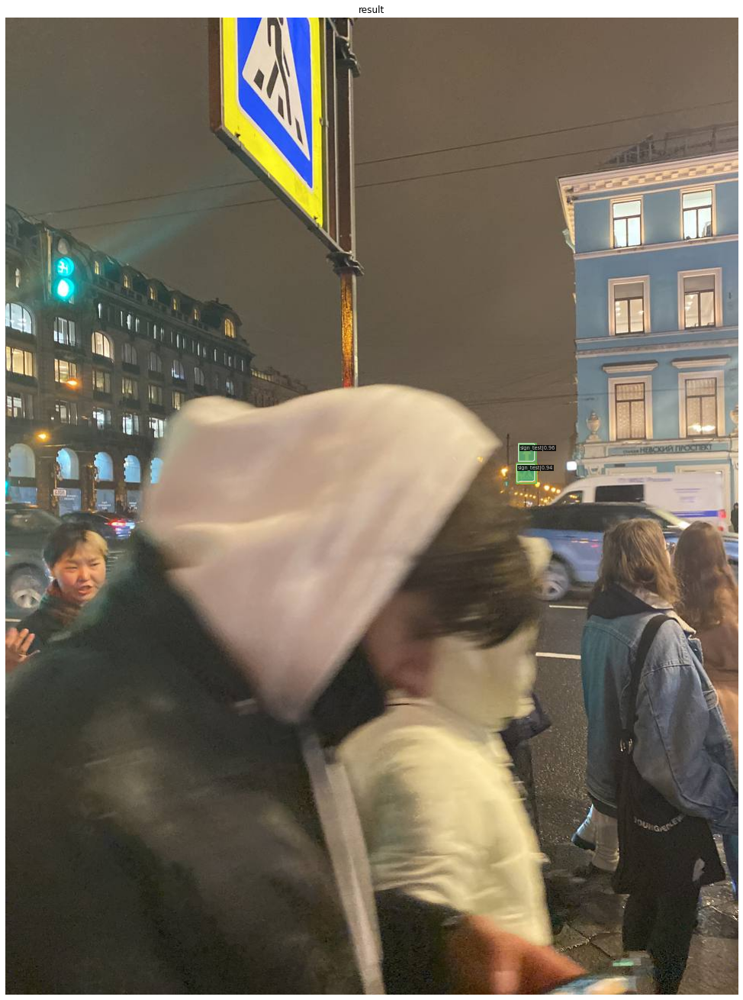

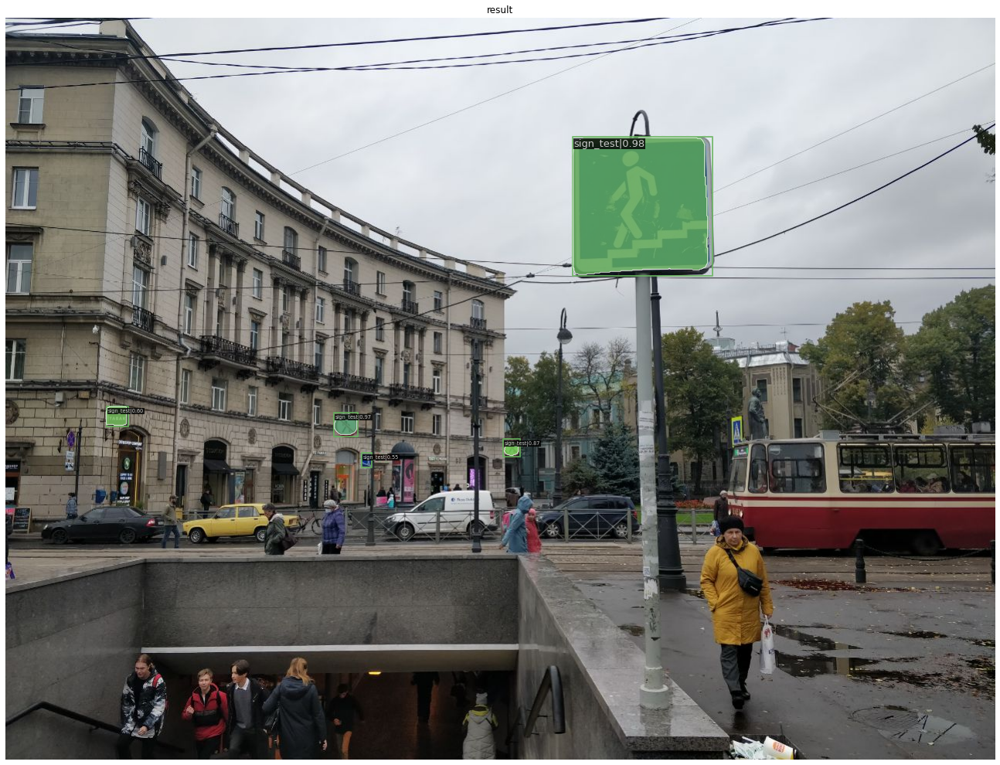

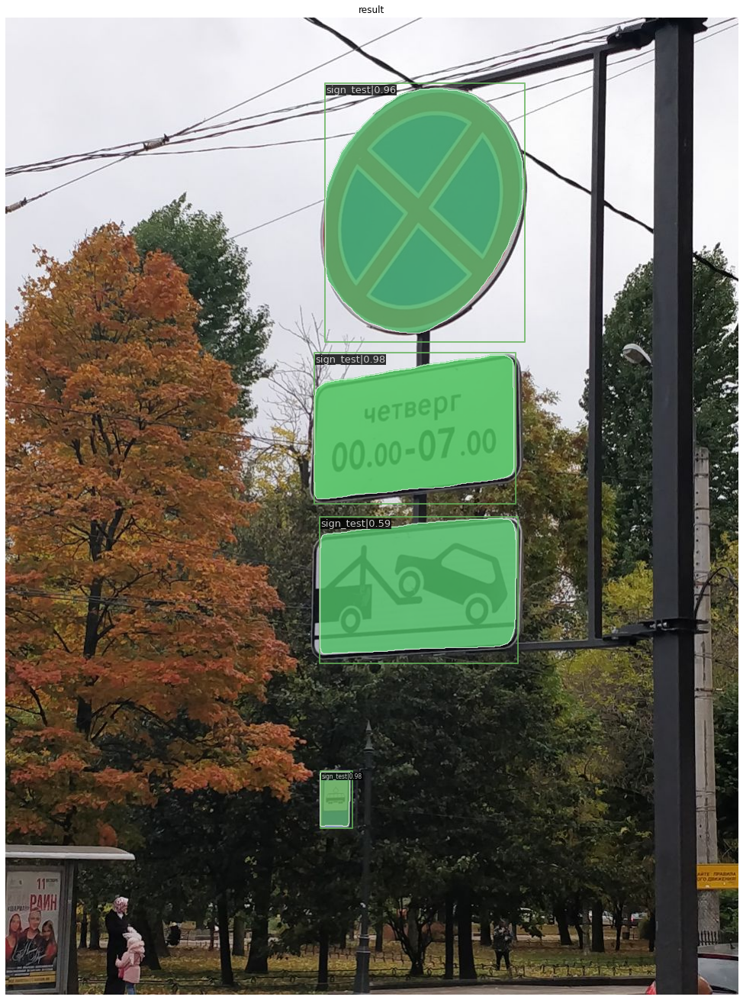

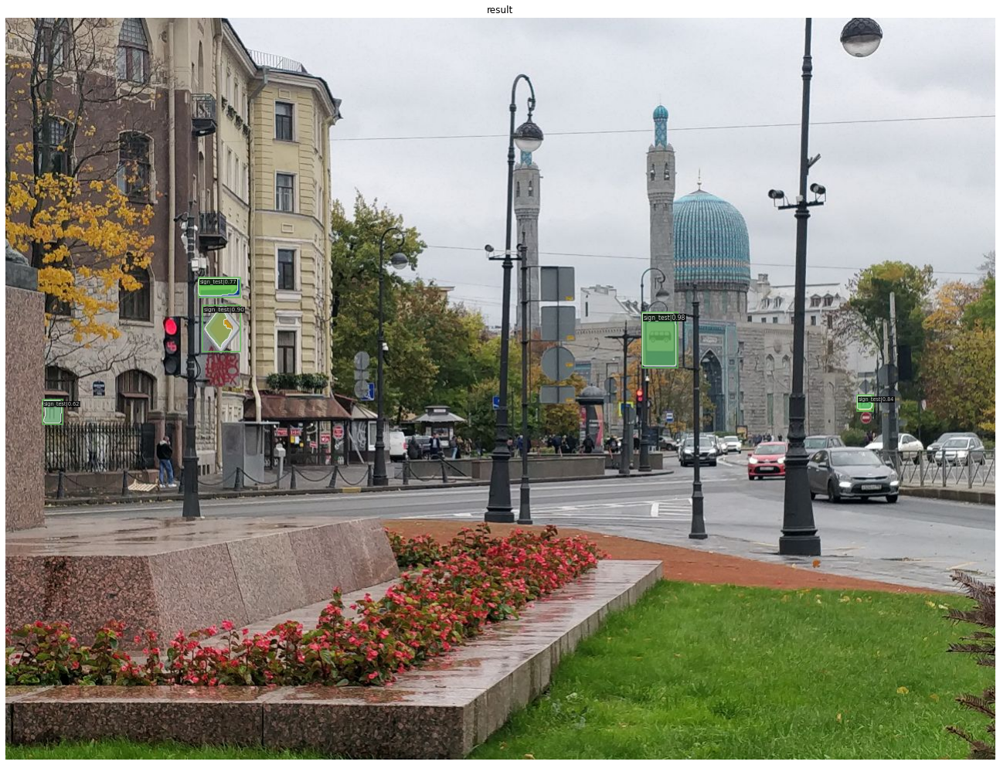

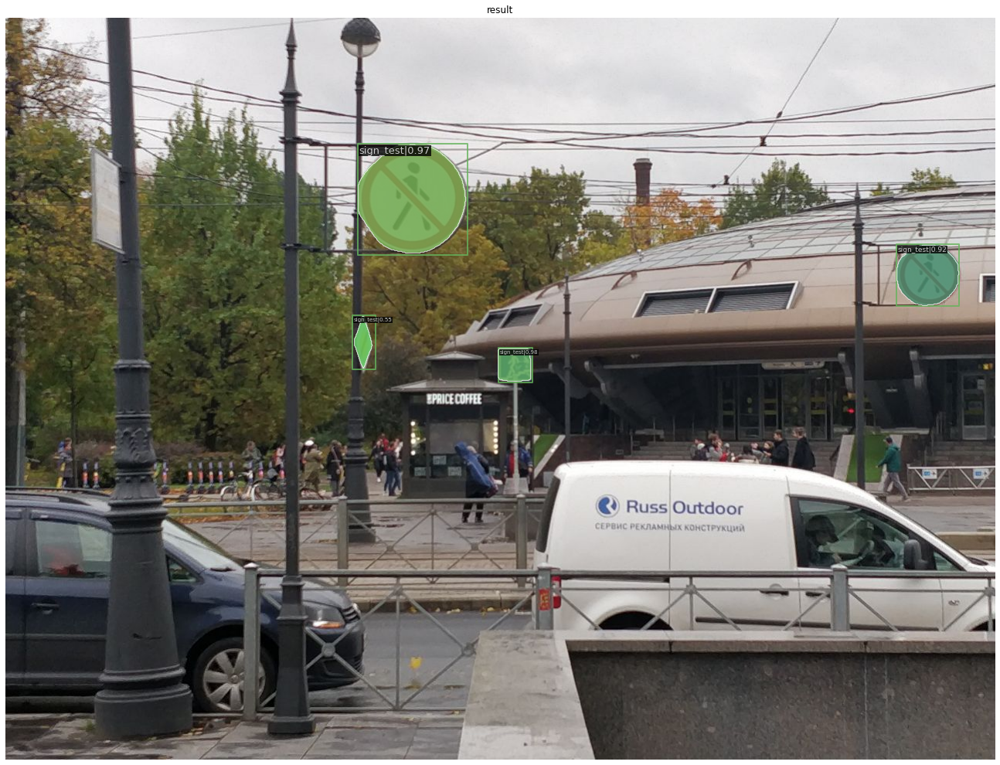

In [ ]:
base_imgs = '/content/drive/MyDrive/signs_segmentation'

for file in os.listdir(base_imgs):
  img = mmcv.imread(f'{base_imgs}/{file}')
  result = inference_detector(model, img)
  show_result_pyplot(model, img, result)